## Categorical Data Processing Using Gower's Distance

In [117]:
import pandas as pd

In [129]:
# Read JSON file into Pandas dataframe
# Dataframe is two-dimensional, tabular data
df = pd.read_json("updated1000.json")

In [130]:
# Don't need to include 'Alerts'
df.drop(df[df['contact_type_display_value'] == 'Alert'].index, inplace = True)

In [131]:
# Separating by categorical first. Will append unstructured text later when applying NLP
df_cat = df[['priority', 'u_ci_class_name_display_value', 'category_display_value', 'cmdb_ci_display_value', 'u_affected_application_display_value', 'product_name', 'assignment_group_display_value', 'knowledge_short_description', 'incident_state_display_value', 'site', 'site_type', 'site_banner', 'site_state', 'contact_type_display_value', 'parent_display_value']]


In [138]:
df_ids = df[['number']]

In [139]:
df_ids

,number
0,INC17365328
1,INC17355996
2,INC19800104
3,INC12345327
4,INC9856462
...,...
995,INC21425352
996,INC22113271
997,INC21771979
998,INC21426047


In [5]:
# Gower's distance can be used to measure how different two records are
# Works for quantitative & qualitative (Dice distance) descriptors
import gower

In [6]:
distance_matrix = gower.gower_matrix(df_cat)

In [7]:
# Each list represents a record and the indices are the comparisons of that record to the rest of the records
distance_matrix

array([[0.        , 0.2       , 0.6166667 , ..., 0.4       , 0.53333336,
        0.53333336],
       [0.2       , 0.        , 0.6166667 , ..., 0.4       , 0.46666667,
        0.46666667],
       [0.6166667 , 0.6166667 , 0.        , ..., 0.6166667 , 0.75      ,
        0.75      ],
       ...,
       [0.4       , 0.4       , 0.6166667 , ..., 0.        , 0.53333336,
        0.53333336],
       [0.53333336, 0.46666667, 0.75      , ..., 0.53333336, 0.        ,
        0.13333334],
       [0.53333336, 0.46666667, 0.75      , ..., 0.53333336, 0.13333334,
        0.        ]], dtype=float32)

In [8]:
import numpy as np

In [9]:
import sys
np.set_printoptions(threshold=sys.maxsize) # Just allows us to view the array in full form

In [10]:
# This array represents the first record and its difference to the reset of the 9999 records
first_row = gower.gower_matrix(df_cat)[0]
display(first_row)

array([0.        , 0.2       , 0.6166667 , 0.6       , 0.46666667,
       0.6       , 0.4       , 0.53333336, 0.68333334, 0.6666667 ,
       0.6666667 , 0.6666667 , 0.6666667 , 0.6666667 , 0.6666667 ,
       0.6666667 , 0.68333334, 0.53333336, 0.68333334, 0.6666667 ,
       0.68333334, 0.6666667 , 0.6666667 , 0.68333334, 0.68333334,
       0.6666667 , 0.6666667 , 0.68333334, 0.6666667 , 0.6666667 ,
       0.53333336, 0.68333334, 0.6666667 , 0.68333334, 0.53333336,
       0.6666667 , 0.6666667 , 0.6666667 , 0.68333334, 0.6666667 ,
       0.68333334, 0.68333334, 0.68333334, 0.6333333 , 0.6333333 ,
       0.53333336, 0.6       , 0.6       , 0.46666667, 0.55      ,
       0.46666667, 0.55      , 0.53333336, 0.41666666, 0.48333332,
       0.48333332, 0.6166667 , 0.6166667 , 0.55      , 0.6166667 ,
       0.4       , 0.5       , 0.6666667 , 0.6666667 , 0.6       ,
       0.4       , 0.4       , 0.4       , 0.4       , 0.4       ,
       0.4       , 0.4       , 0.4       , 0.4       , 0.4    

In [11]:
# The lower the value the closer the similarity
df_cat.loc[[0]]

,priority,u_ci_class_name_display_value,category_display_value,cmdb_ci_display_value,u_affected_application_display_value,product_name,assignment_group_display_value,knowledge_short_description,incident_state_display_value,site,site_type,site_banner,site_state,contact_type_display_value,parent_display_value
0,5,Business Application,Application,None,Compliance Monitoring - Compliance Dashboard,,Asset Protection Fraud,PAWS Archer Error Performing,Assigned,2161.US,Retail,Wal-Mart,CA,Self-service,None


In [12]:
df_cat.loc[[1]]

,priority,u_ci_class_name_display_value,category_display_value,cmdb_ci_display_value,u_affected_application_display_value,product_name,assignment_group_display_value,knowledge_short_description,incident_state_display_value,site,site_type,site_banner,site_state,contact_type_display_value,parent_display_value
1,5,Business Application,Application,None,Compliance Monitoring - Compliance Dashboard,,Asset Protection Fraud,PAWS Archer Error Performing,Assigned,3897.US,Retail,WM Supercenter,ID,Self-service,None


In [13]:
# The distance between Row 0 and Row 2 is 0.7 which indicates a bigger difference.

In [14]:
df_cat.loc[[2]]

,priority,u_ci_class_name_display_value,category_display_value,cmdb_ci_display_value,u_affected_application_display_value,product_name,assignment_group_display_value,knowledge_short_description,incident_state_display_value,site,site_type,site_banner,site_state,contact_type_display_value,parent_display_value
2,4,Active Directory Domain Controller,Security,None,None,,STAR - Parts,LOGC - Windows - System Domain Trust (Laptop),Assigned,6715.US,Transportation - Retail,Maintenance Trucking,SC,Self-service,None


## Unstructured Text Processing using NLP

In [ ]:
# If TqdmWarning below... run this
!conda install -c conda-forge ipywidgets

In [15]:
from sentence_transformers import SentenceTransformer    

/Users/y0n01ab/anaconda3/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [17]:
# Takes short description (add long later)
short_description = df["short_description"]
description = df["description"]
comments = df["comments"]
work_notes = df["work_notes"]

In [18]:
short_description_list = short_description.tolist()
short_description_list = [item if item is not None else '' for item in short_description_list]
description_list = description.tolist()
description_list = [item if item is not None else '' for item in description_list]
comments_list = comments.tolist()
comments_list = [item if item is not None else '' for item in comments_list]
work_notes_list = work_notes.tolist()
work_notes_list = [item if item is not None else '' for item in work_notes_list]

### Translation

In [19]:
# Translate spanish to english with googletrans library
from deep_translator import GoogleTranslator
from langdetect import detect, LangDetectException

In [20]:
def translate_list(sentences):
    for i, sentence in enumerate(sentences):
        try:
            if detect(sentence) == 'es':
                translated_sentence = ""
                if len(sentence) > 4999:
                    # If the sentence is too long, split it into parts and translate each separately
                    parts = [sentence[j:j + 4999] for j in range(0, len(sentence), 4999)]
                    for part in parts:
                        if part:  # Ensure part is not empty
                            translated_parts = GoogleTranslator(source='spanish', target='english').translate(part)
                            translated_sentence += translated_parts
                else:
                    # If the sentence is short enough, translate it as is
                    translated_sentence = GoogleTranslator(source='spanish', target='english').translate(sentence)
                sentences[i] = translated_sentence
        except LangDetectException:
            continue
    return sentences


### Lowercasing (Must do for translation)

In [21]:
def lowercase_list(sentences):
    return [sentence.lower() for sentence in sentences]

In [22]:
short_description_list = lowercase_list(short_description_list)
description_list = lowercase_list(description_list)
comments_list = lowercase_list(comments_list)
work_notes_list = lowercase_list(work_notes_list)

In [23]:
short_description_list = translate_list(short_description_list)
description_list = translate_list(description_list)
comments_list = translate_list(comments_list)
work_notes_list = translate_list(work_notes_list)

In [24]:
textual_data = [] # List of lists with all the textual data to be used for each record
textual_data = [list(x) for x in zip(short_description_list, description_list, comments_list, work_notes_list)]

In [26]:
# 'None' to ''
textual_data = [[item if item is not None else '' for item in sublist] for sublist in textual_data]

In [27]:
textual_data

[['wire will not load impact, keeps giving error message',
  'fixit options:---archer - archer performance issues/errors\nissue details:---wire will not load impact, keeps giving error message\nerror message:---this sight can not be reached\ntask name:---impact: weekly hazardous waste inspection\npath:---wire, impact, then error comes up',
  '',
  '2020-08-18 17:57:27 - r0c02bu (work_notes)\nwent through wire to reach page.\r\nhttps://walmart.solutions-sysrepublic.com/secure4/cpf/core/logon\r\nconnection reset error when trying to access. sending to recommended team by archer\n\n'],
 ['referring to impact, there is continuous login problems on a weekly basis the page will not connect once you are able to log in and complete a questionnaire whe',
  "fixit options:---archer - archer performance issues/errors\nissue details:---referring to impact, there is continuous login problems on a weekly basis the page will not connect once you are able to log in and complete a questionnaire when yo

## Data Preprocessing

### Tokenization

In [28]:
import nltk

In [29]:
from nltk.tokenize import word_tokenize

In [30]:
textual_data_preprocess = [[nltk.word_tokenize(sentence) for sentence in sublist] for sublist in textual_data]


In [31]:
textual_data_preprocess

[[['wire',
   'will',
   'not',
   'load',
   'impact',
   ',',
   'keeps',
   'giving',
   'error',
   'message'],
  ['fixit',
   'options',
   ':',
   '--',
   '-archer',
   '-',
   'archer',
   'performance',
   'issues/errors',
   'issue',
   'details',
   ':',
   '--',
   '-wire',
   'will',
   'not',
   'load',
   'impact',
   ',',
   'keeps',
   'giving',
   'error',
   'message',
   'error',
   'message',
   ':',
   '--',
   '-this',
   'sight',
   'can',
   'not',
   'be',
   'reached',
   'task',
   'name',
   ':',
   '--',
   '-impact',
   ':',
   'weekly',
   'hazardous',
   'waste',
   'inspection',
   'path',
   ':',
   '--',
   '-wire',
   ',',
   'impact',
   ',',
   'then',
   'error',
   'comes',
   'up'],
  [],
  ['2020-08-18',
   '17:57:27',
   '-',
   'r0c02bu',
   '(',
   'work_notes',
   ')',
   'went',
   'through',
   'wire',
   'to',
   'reach',
   'page',
   '.',
   'https',
   ':',
   '//walmart.solutions-sysrepublic.com/secure4/cpf/core/logon',
   'connecti

### Lower casing and Punctuation removal

In [32]:
import string

In [33]:
textual_data_preprocess = [[[word.lower().translate(str.maketrans('', '', string.punctuation)) for word in sublist] for sublist in outer_list] for outer_list in textual_data_preprocess]


In [34]:
textual_data_preprocess

[[['wire',
   'will',
   'not',
   'load',
   'impact',
   '',
   'keeps',
   'giving',
   'error',
   'message'],
  ['fixit',
   'options',
   '',
   '',
   'archer',
   '',
   'archer',
   'performance',
   'issueserrors',
   'issue',
   'details',
   '',
   '',
   'wire',
   'will',
   'not',
   'load',
   'impact',
   '',
   'keeps',
   'giving',
   'error',
   'message',
   'error',
   'message',
   '',
   '',
   'this',
   'sight',
   'can',
   'not',
   'be',
   'reached',
   'task',
   'name',
   '',
   '',
   'impact',
   '',
   'weekly',
   'hazardous',
   'waste',
   'inspection',
   'path',
   '',
   '',
   'wire',
   '',
   'impact',
   '',
   'then',
   'error',
   'comes',
   'up'],
  [],
  ['20200818',
   '175727',
   '',
   'r0c02bu',
   '',
   'worknotes',
   '',
   'went',
   'through',
   'wire',
   'to',
   'reach',
   'page',
   '',
   'https',
   '',
   'walmartsolutionssysrepubliccomsecure4cpfcorelogon',
   'connection',
   'reset',
   'error',
   'when',
   'tr

### Stop word removal

In [35]:
from nltk.corpus import stopwords 
from nltk.tokenize import word_tokenize 

In [36]:
stop_words = set(stopwords.words('english')) 

textual_data_preprocess = [[[word for word in sublist if word.lower() not in stop_words] for sublist in outer_list] for outer_list in textual_data_preprocess]

In [37]:
stop_words.add('US')
stop_words.add('Order status')

In [38]:
textual_data_preprocess

[[['wire', 'load', 'impact', '', 'keeps', 'giving', 'error', 'message'],
  ['fixit',
   'options',
   '',
   '',
   'archer',
   '',
   'archer',
   'performance',
   'issueserrors',
   'issue',
   'details',
   '',
   '',
   'wire',
   'load',
   'impact',
   '',
   'keeps',
   'giving',
   'error',
   'message',
   'error',
   'message',
   '',
   '',
   'sight',
   'reached',
   'task',
   'name',
   '',
   '',
   'impact',
   '',
   'weekly',
   'hazardous',
   'waste',
   'inspection',
   'path',
   '',
   '',
   'wire',
   '',
   'impact',
   '',
   'error',
   'comes'],
  [],
  ['20200818',
   '175727',
   '',
   'r0c02bu',
   '',
   'worknotes',
   '',
   'went',
   'wire',
   'reach',
   'page',
   '',
   'https',
   '',
   'walmartsolutionssysrepubliccomsecure4cpfcorelogon',
   'connection',
   'reset',
   'error',
   'trying',
   'access',
   '',
   'sending',
   'recommended',
   'team',
   'archer']],
 [['referring',
   'impact',
   '',
   'continuous',
   'login',
   'pro

In [39]:
len(textual_data_preprocess)

956

### Lemmatization

In [40]:
from nltk.stem import WordNetLemmatizer 
lemmatizer = WordNetLemmatizer()

In [41]:
import nltk
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Error loading wordnet: <urlopen error [Errno 8] nodename
[nltk_data]     nor servname provided, or not known>
[nltk_data] Error loading omw-1.4: <urlopen error [Errno 8] nodename
[nltk_data]     nor servname provided, or not known>


False

In [42]:
textual_data_preprocess = [[[lemmatizer.lemmatize(word) for word in sublist] for sublist in outer_list] for outer_list in textual_data_preprocess]


In [43]:
textual_data_preprocess

[[['wire', 'load', 'impact', '', 'keep', 'giving', 'error', 'message'],
  ['fixit',
   'option',
   '',
   '',
   'archer',
   '',
   'archer',
   'performance',
   'issueserrors',
   'issue',
   'detail',
   '',
   '',
   'wire',
   'load',
   'impact',
   '',
   'keep',
   'giving',
   'error',
   'message',
   'error',
   'message',
   '',
   '',
   'sight',
   'reached',
   'task',
   'name',
   '',
   '',
   'impact',
   '',
   'weekly',
   'hazardous',
   'waste',
   'inspection',
   'path',
   '',
   '',
   'wire',
   '',
   'impact',
   '',
   'error',
   'come'],
  [],
  ['20200818',
   '175727',
   '',
   'r0c02bu',
   '',
   'worknotes',
   '',
   'went',
   'wire',
   'reach',
   'page',
   '',
   'http',
   '',
   'walmartsolutionssysrepubliccomsecure4cpfcorelogon',
   'connection',
   'reset',
   'error',
   'trying',
   'access',
   '',
   'sending',
   'recommended',
   'team',
   'archer']],
 [['referring',
   'impact',
   '',
   'continuous',
   'login',
   'problem',

## NLP Model

In [46]:
sentences = [' '.join([' '.join(sublist) for sublist in outer_list]) for outer_list in textual_data_preprocess]

In [ ]:
# If Timeout error below... run this
!jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
[W 09:00:19.329 NotebookApp] Loading JupyterLab as a classic notebook (v6) extension.
[W 2023-06-20 09:00:19.331 LabApp] 'iopub_data_rate_limit' has moved from NotebookApp to ServerApp. This config will be passed to ServerApp. Be sure to update your config before our next release.
[W 2023-06-20 09:00:19.331 LabApp] 'iopub_data_rate_limit' has moved from NotebookApp to ServerApp. This config will be passed to ServerApp. Be sure to update your config before our next release.
[I 2023-06-20 09:00:19.332 LabApp] JupyterLab extension loaded from /Users/y0n01ab/anaconda3/lib/python3.10/site-packages/jupyterlab
[I 2023-06-20 09:00:19.332 LabApp] JupyterLab application directo

In [49]:
# Pre-trained model taken from Hugging Face open source library
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Uses the loaded model to transform the input sentences (short_descriptions) into their corresponding vector representations (embeddings). 
# The encode method takes a list of sentences or paragraphs and returns a list of corresponding embeddings as a 2D numpy array.
# Embeddings is the conversion of text to vector of real numbers
embeddings = model.encode(sentences)
print(embeddings)

[[-1.69003345e-02 -2.18888354e-02  1.39753716e-02  6.92777708e-02
  -1.52550833e-02  5.76389320e-02  3.32488082e-02 -2.50804741e-02
  -9.30508673e-02  1.02950791e-02  1.05049799e-03  3.72408307e-03
  -7.04699606e-02  5.56311198e-02 -6.26980513e-03  9.84009132e-02
   3.36428955e-02 -7.93967322e-02  4.70919572e-02 -1.63022112e-02
   1.06872739e-02  5.86088398e-04 -5.72754666e-02  6.01428300e-02
   7.79480953e-03 -8.17358717e-02 -4.41986695e-02  2.98589803e-02
  -5.33782206e-02 -3.78765874e-02 -1.87217537e-02  4.47133742e-02
  -6.91640899e-02  1.09573230e-02  3.78796235e-02  2.55959500e-02
  -5.27140722e-02  4.88225371e-02  4.58635911e-02 -6.22116448e-03
   2.74922587e-02 -3.95868383e-02 -3.74345444e-02 -4.33381498e-02
  -3.26705575e-02 -7.97151551e-02  1.29896663e-02 -9.43493098e-03
   7.70966485e-02  4.54979166e-02 -2.02942174e-02  8.76215752e-03
   2.54639573e-02 -4.41724397e-02  1.55154794e-01 -5.53950593e-02
  -1.17114512e-02  1.29957488e-02  2.78643295e-02 -8.85583982e-02
   6.54597

In [50]:
import numpy as np

In [52]:
dftest = df.copy()

In [184]:
dftest

,embedding_383_1687270568.398984,embedding_382_1687270568.398785,embedding_381_1687270568.398589,embedding_380_1687270568.3983932,embedding_379_1687270568.398193,embedding_378_1687270568.397996,embedding_377_1687270568.3978,embedding_376_1687270568.3976011,embedding_375_1687270568.397402,embedding_374_1687270568.397196,...,site_banner,site_state,work_notes,short_description,description,comments,close_notes,correlation_id,problem_id_display_value,parent_display_value
0,-0.065473,-0.035365,0.035428,0.073008,-0.015339,-0.026937,-0.095662,0.018676,0.019204,-0.017627,...,Wal-Mart,CA,2020-08-18 17:57:27 - r0c02bu (work_notes)\nWe...,"Wire will not load impact, keeps giving error ...",FixIT Options:---Archer - Archer Performance i...,None,None,None,None,None
1,0.000423,-0.043147,-0.023866,0.112627,0.007905,0.011922,-0.048960,0.023830,0.043273,-0.008220,...,WM Supercenter,ID,2020-08-17 11:26:16 - vn50d3z (work_notes)\nFS...,"Referring to impact, there is continuous login...",FixIT Options:---Archer - Archer Performance i...,None,None,None,None,None
2,-0.034838,-0.051222,-0.000496,0.098628,-0.032131,0.053209,0.012076,-0.061213,-0.045913,-0.083344,...,Maintenance Trucking,SC,2021-01-06 19:10:56 - m0b01vz (work_notes)\nAt...,LOGC - Windows - System Domain Trust (Laptop),Contact: 18646821511\r\nAvailability: 200pm un...,2021-01-06 19:11:17 - m0b01vz (comments)\nPlea...,None,None,None,None
3,0.026035,-0.051794,-0.004110,0.112173,-0.041723,0.019114,-0.074657,-0.037568,0.050808,-0.039748,...,WM Supercenter,AR,2023-06-12 17:41:58 - system (work_notes)\ntds...,EMS - Applications missing on single handheld,TRACE Options:---App missing from handheld\nDe...,None,None,None,PRB0065472,PRB0065472
4,0.039088,-0.075424,-0.003948,0.076724,0.001137,-0.005367,-0.085822,-0.000205,0.030190,0.012641,...,WM Supercenter,PA,2020-11-14 12:15:08 - svcxcall_automation (wor...,EMS - Applications missing on single handheld,TRACE Options:---Handhelds - Applications Miss...,2020-03-12 13:59:38 - c0s01b3 (comments)\nBeth...,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,-0.056180,-0.043859,-0.003968,0.000498,0.116182,0.105893,0.007906,0.046280,-0.028608,0.063896,...,WM Supercenter,TX,2021-04-17 18:05:18 - svcxcall_automation (wor...,IIP: US Stores | GIF | Orders are not batching...,WorkAround --- Stores will have to manually di...,None,None,None,None,None
996,0.061183,-0.124437,-0.001457,0.131645,0.060668,0.017552,-0.024682,0.062707,-0.053441,-0.094654,...,Dairy Plant,IN,2021-11-19 14:57:17 - kwhaski (work_notes)\nUp...,LOGC - Hardware - Laptop - Hotswap,Contact: 260-715-5190\r\nAvailability: 8:15 AM...,2022-04-20 12:33:22 - svcxcall_automation (com...,None,None,None,PRB0050837
997,-0.042233,0.000808,-0.041821,0.103341,0.061581,0.088595,-0.040666,0.076620,-0.069221,0.004612,...,WM Supercenter,CA,2021-05-12 19:29:22 - s0m0boi (work_notes)\nAs...,bakery/deli department are successfully orderi...,None,2021-05-12 20:27:57 - rdmarti (comments)\nwe a...,None,None,None,None
998,-0.032030,-0.026422,0.042349,0.024314,0.063149,0.029683,-0.007374,0.086845,-0.051466,0.000891,...,WM Supercenter,WV,2022-02-04 13:53:12 - svcxcall_automation (wor...,R6 | EMS GIF 2.0 Dispensing Issues in Pickup C...,Is this happening with all orders? --- Yes\nIs...,None,None,None,None,None


In [53]:
import time # Using time to assign unique ids

for x in range(len(embeddings[0])):
    # Create a unique column name for each dimension
    column_name = "embedding_" + str(x) + "_" + str(time.time())
    
    # Insert the column into the dataframe
    dftest.insert(0, column_name, np.array(embeddings).T[x])


/var/folders/jc/qnyg1dh11194psn4f_r8rh680000gq/T/ipykernel_37130/808381103.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  dftest.insert(0, column_name, np.array(embeddings).T[x])
/var/folders/jc/qnyg1dh11194psn4f_r8rh680000gq/T/ipykernel_37130/808381103.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  dftest.insert(0, column_name, np.array(embeddings).T[x])
/var/folders/jc/qnyg1dh11194psn4f_r8rh680000gq/T/ipykernel_37130/808381103.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of ca

In [56]:
# Now the distance matrix contains data obtained from both the Gower's distance procedure and NLP procedure
distance_matrix = gower.gower_matrix(dftest)

In [58]:
distance_matrix

array([[0.        , 0.13529317, 0.19994217, 0.20596361, 0.19280608,
        0.20460142, 0.19182613, 0.19342068, 0.19275117, 0.19296545,
        0.19877714, 0.2028844 , 0.20168239, 0.19901714, 0.20884416,
        0.1967148 , 0.20188631, 0.18602234, 0.20392577, 0.19542083,
        0.20544848, 0.19911432, 0.1946345 , 0.19768511, 0.19456856,
        0.19044949, 0.18088114, 0.19765292, 0.2079212 , 0.19813156,
        0.18352765, 0.2018598 , 0.20050867, 0.19897304, 0.18377961,
        0.1980677 , 0.20007423, 0.2153665 , 0.19617866, 0.1856053 ,
        0.19619769, 0.1996083 , 0.19862328, 0.19750118, 0.20177752,
        0.19163032, 0.20993574, 0.20868643, 0.1935021 , 0.21694253,
        0.17446885, 0.20508866, 0.2021245 , 0.19490263, 0.18588834,
        0.19182672, 0.19275358, 0.22474769, 0.19984946, 0.21970668,
        0.18943776, 0.21134709, 0.21894854, 0.21508963, 0.22723931,
        0.21575402, 0.21308781, 0.21257403, 0.18499012, 0.18960236,
        0.21637347, 0.21660379, 0.21554618, 0.18

In [98]:
with open("distances.txt", "w") as f:
    f.write(str(distance_matrix))

In [201]:
numbers = df['number']

In [203]:
type(numbers)

pandas.core.series.Series

In [93]:
df_dist = pd.DataFrame(distance_matrix)

In [204]:
df_dist.index, df_dist.columns = numbers, numbers

In [205]:
df_dist

number,INC17365328,INC17355996,INC19800104,INC12345327,INC9856462,INC11842378,INC14712283,INC15955602,INC20703843,INC20703620,...,INC20215288,INC21425690,INC21425356,INC21423834,INC21423824,INC21425352,INC22113271,INC21771979,INC21426047,INC21439891
number,,,,,,,,,,,,,,,,,,,,,
INC17365328,0.000000,0.135293,0.199942,0.205964,0.192806,0.204601,0.191826,0.193421,0.192751,0.192965,...,0.208291,0.188689,0.172025,0.195048,0.225029,0.224842,0.217882,0.198492,0.189135,0.221869
INC17355996,0.135293,0.000000,0.200250,0.213103,0.196598,0.213995,0.208801,0.177045,0.207610,0.193819,...,0.219023,0.188253,0.173840,0.200127,0.207022,0.207501,0.222508,0.200210,0.187831,0.204298
INC19800104,0.199942,0.200250,0.000000,0.210527,0.199903,0.222092,0.204879,0.210161,0.222536,0.230748,...,0.215402,0.209138,0.193216,0.220966,0.241535,0.239530,0.179745,0.220716,0.225062,0.235299
INC12345327,0.205964,0.213103,0.210527,0.000000,0.107853,0.099237,0.129029,0.219690,0.199696,0.206641,...,0.237437,0.199358,0.195150,0.213947,0.241518,0.239315,0.208803,0.217112,0.207059,0.239921
INC9856462,0.192806,0.196598,0.199903,0.107853,0.000000,0.125551,0.105085,0.209807,0.196883,0.198562,...,0.223311,0.195143,0.187484,0.199665,0.232226,0.226162,0.203377,0.209644,0.191749,0.225324
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
INC21425352,0.224842,0.207501,0.239530,0.239315,0.226162,0.246062,0.219725,0.208790,0.207504,0.170045,...,0.226761,0.175199,0.198235,0.185480,0.103436,0.000000,0.240310,0.179468,0.157778,0.095622
INC22113271,0.217882,0.222508,0.179745,0.208803,0.203377,0.212767,0.211940,0.211789,0.236421,0.223993,...,0.232362,0.224371,0.209716,0.214393,0.245117,0.240310,0.000000,0.215848,0.216844,0.237029
INC21771979,0.198492,0.200210,0.220716,0.217112,0.209644,0.222027,0.208027,0.180796,0.214985,0.185484,...,0.207852,0.174962,0.199994,0.187608,0.182134,0.179468,0.215848,0.000000,0.173538,0.177338


In [207]:
# Convert distance matrix into array
a = np.array(distance_matrix)

In [208]:
minval = 0.10
similar_pairs = []
# Iterate over every element in 2D array
for i in range(len(a)):
    for j in range(len(a[0])):
        # Finding most similar values. 0.15 is threshold value for similarity
        # Smallest value in matrix that is greater than 0.15
        if a[i,j] < minval and a[i,j] > 0.02 and i != j:
            similar_pairs.append((i, j, a[i,j]))

In [209]:
similar_pairs

[(3, 5, 0.09923706),
 (3, 291, 0.07137814),
 (5, 3, 0.09923706),
 (5, 291, 0.08922041),
 (8, 16, 0.096219085),
 (8, 23, 0.088021174),
 (8, 27, 0.0830618),
 (8, 31, 0.090926215),
 (8, 33, 0.09081731),
 (8, 38, 0.09912215),
 (8, 40, 0.08486044),
 (8, 42, 0.07518362),
 (9, 10, 0.08111372),
 (9, 12, 0.09025554),
 (9, 22, 0.08458844),
 (9, 25, 0.08127818),
 (9, 26, 0.09122932),
 (9, 32, 0.09292011),
 (10, 9, 0.08111372),
 (10, 11, 0.08234762),
 (10, 12, 0.0786808),
 (10, 15, 0.08776545),
 (10, 22, 0.09098109),
 (10, 25, 0.074941926),
 (10, 26, 0.09722021),
 (10, 32, 0.086991765),
 (10, 35, 0.091583624),
 (10, 36, 0.089809366),
 (11, 10, 0.08234762),
 (11, 12, 0.059010774),
 (11, 15, 0.067252696),
 (11, 22, 0.09916118),
 (11, 25, 0.089395456),
 (11, 32, 0.08979142),
 (11, 35, 0.089636266),
 (11, 36, 0.08764109),
 (11, 102, 0.08608718),
 (11, 670, 0.084014334),
 (12, 9, 0.09025554),
 (12, 10, 0.0786808),
 (12, 11, 0.059010774),
 (12, 15, 0.07066935),
 (12, 25, 0.080261685),
 (12, 32, 0.090605

In [210]:
with open("similar_pairs2.txt", "w") as f:
    f.write(str(similar_pairs))

In [75]:
import matplotlib.pyplot as plt

In [213]:
# record 11 and 12 have 0.059 difference
with pd.option_context('display.max_colwidth', None):
    print(df.iloc[955])

number                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                 INC21439891
priority                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             

In [214]:
with pd.option_context('display.max_colwidth', None):
    print(df.iloc[954])

number                                                                                                                                                                                                                                                                                                                                                                                                  INC21426047
priority                                                                                                                                                                                                                                                                                                                                                                                                          5
u_ci_class_name_display_value                                                                                                                                                                   

In [182]:
with pd.option_context('display.max_colwidth', None):
    print(df.iloc[841])

number                                                                                                                                                                                                                                                                                                                                                                                      INC22001683
priority                                                                                                                                                                                                                                                                                                                                                                                              5
u_ci_class_name_display_value                                                                                                                                                                                           

In [183]:
with pd.option_context('display.max_colwidth', None):
    print(df.iloc[848])

number                                                                                                                                                                                                                                                                                                                                                                                                                                                        INC21996148
priority                                                                                                                                                                                                                                                                                                                                                                                                                                                                5
u_ci_class_name_display_value                                                       

In [70]:
with pd.option_context('display.max_colwidth', None):
    print(df.iloc[283])

number                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  

In [136]:
with pd.option_context('display.max_colwidth', None):
    print(df.iloc[730])

number                                                                                                                                                                      INC23063327
priority                                                                                                                                                                              5
u_ci_class_name_display_value                                                                                                                                            Handheld / PDA
category_display_value                                                                                                                                                    Mobile Device
cmdb_ci_display_value                                                                                                                                                              None
u_affected_application_display_value                                            

In [185]:
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.spatial.distance import squareform
import matplotlib.pyplot as plt

In [186]:
distance_matrix_full = distance_matrix

In [187]:
distance_condensed = squareform(distance_matrix_full)

In [188]:
distance_condensed

array([0.13529317, 0.19994217, 0.20596361, 0.19280608, 0.20460142,
       0.19182613, 0.19342068, 0.19275117, 0.19296545, 0.19877714,
       0.2028844 , 0.20168239, 0.19901714, 0.20884416, 0.1967148 ,
       0.20188631, 0.18602234, 0.20392577, 0.19542083, 0.20544848,
       0.19911432, 0.1946345 , 0.19768511, 0.19456856, 0.19044949,
       0.18088114, 0.19765292, 0.2079212 , 0.19813156, 0.18352765,
       0.2018598 , 0.20050867, 0.19897304, 0.18377961, 0.1980677 ,
       0.20007423, 0.2153665 , 0.19617866, 0.1856053 , 0.19619769,
       0.1996083 , 0.19862328, 0.19750118, 0.20177752, 0.19163032,
       0.20993574, 0.20868643, 0.1935021 , 0.21694253, 0.17446885,
       0.20508866, 0.2021245 , 0.19490263, 0.18588834, 0.19182672,
       0.19275358, 0.22474769, 0.19984946, 0.21970668, 0.18943776,
       0.21134709, 0.21894854, 0.21508963, 0.22723931, 0.21575402,
       0.21308781, 0.21257403, 0.18499012, 0.18960236, 0.21637347,
       0.21660379, 0.21554618, 0.18489037, 0.20702896, 0.21042

In [189]:
linked = linkage(distance_condensed, 'ward')

In [190]:
plt.figure(figsize=(10,7))

<Figure size 1000x700 with 0 Axes>

<Figure size 1000x700 with 0 Axes>

{'icoord': [[5.0, 5.0, 15.0, 15.0],
  [25.0, 25.0, 35.0, 35.0],
  [10.0, 10.0, 30.0, 30.0],
  [45.0, 45.0, 55.0, 55.0],
  [50.0, 50.0, 65.0, 65.0],
  [57.5, 57.5, 75.0, 75.0],
  [20.0, 20.0, 66.25, 66.25],
  [85.0, 85.0, 95.0, 95.0],
  [90.0, 90.0, 105.0, 105.0],
  [115.0, 115.0, 125.0, 125.0],
  [135.0, 135.0, 145.0, 145.0],
  [120.0, 120.0, 140.0, 140.0],
  [130.0, 130.0, 155.0, 155.0],
  [97.5, 97.5, 142.5, 142.5],
  [43.125, 43.125, 120.0, 120.0],
  [165.0, 165.0, 175.0, 175.0],
  [170.0, 170.0, 185.0, 185.0],
  [195.0, 195.0, 205.0, 205.0],
  [177.5, 177.5, 200.0, 200.0],
  [215.0, 215.0, 225.0, 225.0],
  [235.0, 235.0, 245.0, 245.0],
  [220.0, 220.0, 240.0, 240.0],
  [255.0, 255.0, 265.0, 265.0],
  [230.0, 230.0, 260.0, 260.0],
  [188.75, 188.75, 245.0, 245.0],
  [81.5625, 81.5625, 216.875, 216.875],
  [275.0, 275.0, 285.0, 285.0],
  [280.0, 280.0, 295.0, 295.0],
  [287.5, 287.5, 305.0, 305.0],
  [315.0, 315.0, 325.0, 325.0],
  [320.0, 320.0, 335.0, 335.0],
  [296.25, 296.25, 327

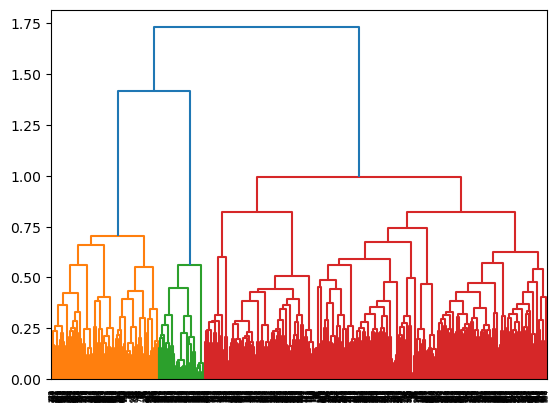

In [191]:
dendrogram(linked, orientation='top', labels=range(len(distance_matrix_full)), distance_sort='descending', show_leaf_counts=True)

In [192]:
plt.show()

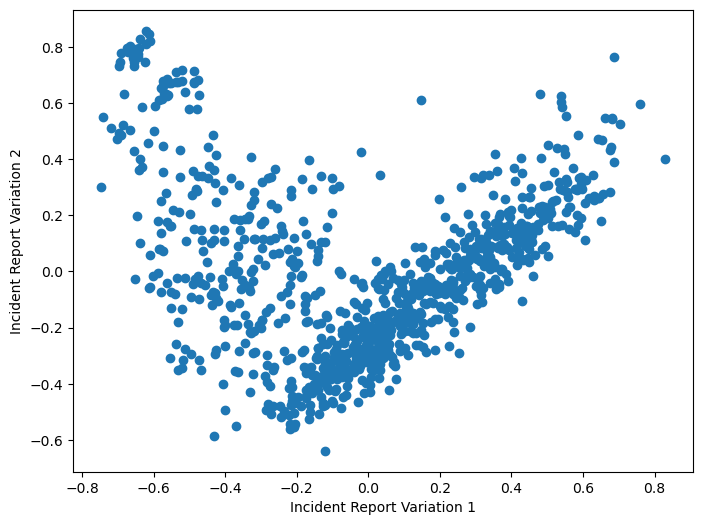

In [199]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Perform PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(distance_matrix_full)

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(pca_result[:, 0], pca_result[:, 1])
plt.xlabel('Incident Report Variation 1')
plt.ylabel('Incident Report Variation 2')
plt.show()
